In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import contextily as ctx
import seaborn as sns

# Read the Excel file into a DataFrame
df = pd.read_excel("results.xlsx")

# Create a GeoDataFrame from the DataFrame
gdf = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df['Longitude'], df['Latitude'])
)

In [2]:
gdf

,Link,RentPrice,Surface,Bedrooms,Bathrooms,LastUpdate,Neighborhood,Location,Seller,PropertySubtype,Description,Latitude,Longitude,DistanceToCenter,Floor,geometry
0,https://www.habitaclia.com/alquiler-piso-con_3...,2450,156,3.0,3.0,02/01/2023,Les Corts,NaN,PROFESSIONAL,FLAT,"Ref: 103755\n\nPiso en alquiler de 156 m², muy...",41.384470,2.110728,5.541253,NaN,POINT (2.11073 41.38447)
1,https://www.habitaclia.com/alquiler-piso-funci...,850,27,1.0,1.0,02/01/2023,Esquerra Alta de l'Eixample,Avinguda de Josep Tarradellas,PROFESSIONAL,FLAT,"Bonito piso de 27 m, amueblado, ideal para per...",41.386516,2.142926,2.884969,NaN,POINT (2.14293 41.38652)
2,https://www.habitaclia.com/alquiler-piso-con_t...,1290,45,2.0,1.0,02/01/2023,Vila de Gracia,Carrer de Tordera 55,PROFESSIONAL,FLAT,A continuación le presentamos una vivienda co...,41.402398,2.162556,2.519144,NaN,POINT (2.16256 41.40240)
3,https://www.habitaclia.com/alquiler-piso-de_80...,1600,80,3.0,1.0,02/01/2023,Sagrada Familia,Castillejos,PROFESSIONAL,FLAT,"Vivienda de 80 metros, reformada recientemente...",41.407584,2.176920,2.784450,NaN,POINT (2.17692 41.40758)
4,https://www.habitaclia.com/alquiler-piso-vivie...,1700,115,4.0,2.0,02/01/2023,Esquerra Alta de l'Eixample,LONDRES,PROFESSIONAL,FLAT,"Estupenda vivienda de 115m2 (95 útiles), distr...",51.507218,-0.127586,1139.367038,NaN,POINT (-0.12759 51.50722)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4180,https://www.habitaclia.com/alquiler-piso-el_po...,2100,150,4.0,2.0,02/12/2022,Poblenou,"del Poblenou, .",PRIVATE,FLAT,Piso de 150 m2 aproximadamente en Rambla del P...,41.403355,2.202884,3.159278,NaN,POINT (2.20288 41.40335)
4181,https://www.habitaclia.com/alquiler-piso-con_3...,1100,90,3.0,2.0,30/11/2022,La Marina-Montjuic,Carrer dels Alts Forns,PROFESSIONAL,FLAT,Precioso piso a estrenar con acabados de gran ...,41.357952,2.139122,4.185492,NaN,POINT (2.13912 41.35795)
4182,https://www.habitaclia.com/alquiler-piso-bonit...,1250,80,1.0,2.0,21/11/2022,Tres Torres,Angli,PROFESSIONAL,FLAT,Bonito piso excusivo de una habitación en Sarr...,41.400906,2.125186,4.787668,NaN,POINT (2.12519 41.40091)
4183,https://www.habitaclia.com/alquiler-piso-bonit...,1250,80,1.0,2.0,21/11/2022,Tres Torres,Angli,PROFESSIONAL,FLAT,Bonito piso excusivo de una habitación en Sarr...,41.400906,2.125186,4.787668,NaN,POINT (2.12519 41.40091)


In [3]:
# Checking where I have NaN and what to do with them

gdf.isna().sum()

Link                   0
RentPrice              0
Surface                0
Bedrooms             126
Bathrooms             55
LastUpdate             0
Neighborhood           0
Location            1500
Seller                 0
PropertySubtype        0
Description           17
Latitude               0
Longitude              0
DistanceToCenter       0
Floor               3735
geometry               0
dtype: int64

In [4]:
# Dropping Floor and imputing Bedrooms and Bathrooms with the mode.
# Location can be dropped since I already have the Longitude and Latitude, also the Neighborhood.
# Dropping more, not needed for analysis: Link, LastUpdate, Seller, PropertySubtype, Description

# Dropping
gdf = gdf.drop(columns=['Link', 'LastUpdate', 'Location', 'Seller', 'PropertySubtype', 'Description', 'Floor'])



# Imputing mode
from scipy.stats import mode

# Get the mode of the column
mode = gdf['Bedrooms'].mode()

# Impute the mode into missing values
gdf['Bedrooms'] = gdf['Bedrooms'].fillna(mode[0])




# Get the mode of the column
mode2 = gdf['Bathrooms'].mode()

# Impute the mode into missing values
gdf['Bathrooms'] = gdf['Bathrooms'].fillna(mode2[0])

In [5]:
gdf.isna().sum()

RentPrice           0
Surface             0
Bedrooms            0
Bathrooms           0
Neighborhood        0
Latitude            0
Longitude           0
DistanceToCenter    0
geometry            0
dtype: int64

In [6]:
gdf.shape

(4185, 9)

In [7]:
# Dropping rentals where the surface area is below 10 (not an accomodation)

gdf = gdf.drop(gdf[gdf['Surface'] < 10].index)
gdf.shape

(4180, 9)

In [8]:
# Dropping rentals where rent price is over 50.000 (user should have selected 'sale' instead of 'rent')

gdf = gdf.drop(gdf[gdf['RentPrice'] > 50000].index)
gdf.shape

(4178, 9)

In [9]:
# Dropping rentals that are more than 9 km away from the city centre (hence not in Barcelona)

gdf = gdf.drop(gdf[gdf['DistanceToCenter'] > 9].index)
gdf.shape

(4167, 9)

In [10]:
# Dropping rentals that have more than 20 bedrooms (probably a whole building or mistake)

gdf = gdf.drop(gdf[gdf['Bedrooms'] > 20].index)
gdf.shape

(4167, 9)

In [11]:
# Dropping rentals that have more than 20 bathrooms (probably a whole building or mistake)

gdf = gdf.drop(gdf[gdf['Bathrooms'] > 20].index)
gdf.shape

(4167, 9)

In [12]:
# Calculating the price per m² as a new column

gdf['PricePerSquareMeter'] = gdf['RentPrice'] / gdf['Surface']

In [13]:
# Dropping rentals that have a rent per square meter of under 5 Euros

gdf = gdf.drop(gdf[gdf['PricePerSquareMeter'] < 5].index)
gdf.shape

(4167, 10)

In [14]:
gdf.head()

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039


<AxesSubplot: xlabel='Neighborhood', ylabel='PricePerSquareMeter'>

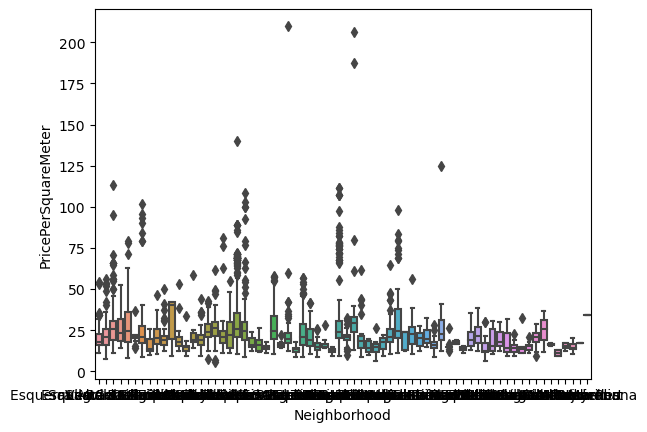

In [15]:
# Create a boxplot that shows the price per square meter for each neighboorhood

sns.boxplot(x='Neighborhood', y='PricePerSquareMeter', data=gdf)

#### Not too nice to plot yet because there are too many unique neighborhoods. Let's try to combine the dataframe with some more (that also have districts) and see if it's easier to plot with only the few districts.

In [16]:
# Read shapefile of districts into a GeoDataFrame
shp = gpd.read_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/Distritos de Barcelona/shapefiles_barcelona_distrito.shp')

shp.head()

,cartodb_id,c_distri,n_distri,homes,dones,area,perim,coord_x,coord_y,web_1,web_2,web_3,geometry
0,5,05,SarriÃÂ -Sant Gervasi,67799,80113,2.009280e+07,37563.642237,425388.507986,4.585170e+06,http://www.bcn.cat/sarria-santgervasi,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...,"MULTIPOLYGON (((2.07212 41.41270, 2.07050 41.4..."
1,7,07,Horta-GuinardÃÂ³,79017,89075,1.194708e+07,20413.187364,429117.618770,4.586950e+06,http://www.bcn.cat/horta-guinardo,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...,"POLYGON ((2.17616 41.42544, 2.17654 41.42500, ..."
2,1,01,Ciutat Vella,53968,48379,4.368465e+06,21035.207261,431616.773990,4.581564e+06,http://www.bcn.cat/ciutatvella,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...,"POLYGON ((2.18239 41.39143, 2.18346 41.39061, ..."
3,2,02,Eixample,123571,142906,7.476392e+06,13902.573980,430243.353657,4.582773e+06,http://www.bcn.cat/eixample,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...,"POLYGON ((2.18239 41.39143, 2.18135 41.39222, ..."
4,3,03,Sants-MontjuÃÂ¯c,87877,95243,2.294042e+07,47125.925905,428562.773279,4.578163e+06,http://www.bcn.cat/sants-montjuic,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...,"POLYGON ((2.16785 41.37498, 2.16856 41.37495, ..."


In [17]:
# Perform the left join
gdf_districts = gpd.sjoin(gdf, shp, how='left', op='intersects')

C:\Users\a\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3373: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
C:\Users\a\AppData\Local\Temp\ipykernel_16296\2333756455.py:2: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: None
Right CRS: EPSG:4326

  gdf_districts = gpd.sjoin(gdf, shp, how='left', op='intersects')


In [18]:
display(gdf_districts)
display(gdf_districts.shape)

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter,...,n_distri,homes,dones,area,perim,coord_x,coord_y,web_1,web_2,web_3
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128,...,Les Corts,38331.0,43939.0,6.017532e+06,12481.472647,426369.646389,4.582295e+06,http://www.bcn.cat/lescorts,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481,...,Eixample,123571.0,142906.0,7.476392e+06,13902.573980,430243.353657,4.582773e+06,http://www.bcn.cat/eixample,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667,...,GrÃÂ cia,55611.0,65891.0,4.185517e+06,12280.060880,429253.013001,4.584840e+06,http://www.bcn.cat/gracia,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000,...,Eixample,123571.0,142906.0,7.476392e+06,13902.573980,430243.353657,4.582773e+06,http://www.bcn.cat/eixample,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039,...,SarriÃÂ -Sant Gervasi,67799.0,80113.0,2.009280e+07,37563.642237,425388.507986,4.585170e+06,http://www.bcn.cat/sarria-santgervasi,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4180,2100,150,4.0,2.0,Poblenou,41.403355,2.202884,3.159278,POINT (2.20288 41.40335),14.000000,...,Sant MartÃÂ­,113572.0,122147.0,1.052376e+07,20736.527911,433330.835564,4.584520e+06,http://www.bcn.cat/santmarti,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
4181,1100,90,3.0,2.0,La Marina-Montjuic,41.357952,2.139122,4.185492,POINT (2.13912 41.35795),12.222222,...,Sants-MontjuÃÂ¯c,87877.0,95243.0,2.294042e+07,47125.925905,428562.773279,4.578163e+06,http://www.bcn.cat/sants-montjuic,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
4182,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,...,SarriÃÂ -Sant Gervasi,67799.0,80113.0,2.009280e+07,37563.642237,425388.507986,4.585170e+06,http://www.bcn.cat/sarria-santgervasi,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...
4183,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,...,SarriÃÂ -Sant Gervasi,67799.0,80113.0,2.009280e+07,37563.642237,425388.507986,4.585170e+06,http://www.bcn.cat/sarria-santgervasi,http://www.bcn.cat/estadistica/catala/dades/in...,http://www.bcn.cat/estadistica/catala/dades/gu...


(4167, 23)

In [19]:
# Cleaning up my new geodataframe from unneeded columns

gdf_districts.columns

# Seems like I only need my district names 'n_distri' after the spacial join from the district shape file

Index(['RentPrice', 'Surface', 'Bedrooms', 'Bathrooms', 'Neighborhood',
       'Latitude', 'Longitude', 'DistanceToCenter', 'geometry',
       'PricePerSquareMeter', 'index_right', 'cartodb_id', 'c_distri',
       'n_distri', 'homes', 'dones', 'area', 'perim', 'coord_x', 'coord_y',
       'web_1', 'web_2', 'web_3'],
      dtype='object')

In [20]:
gdf_districts = gdf_districts.drop(columns=['index_right', 'cartodb_id', 'c_distri', 'homes', 'dones', 'area', 'perim', 'coord_x', 'coord_y','web_1', 'web_2', 'web_3'])

In [21]:
gdf_districts['n_distri'].unique()

array(['Les Corts', 'Eixample', 'GrÃ\x83Â\xa0cia',
       'SarriÃ\x83Â\xa0-Sant Gervasi', 'Sants-MontjuÃ\x83Â¯c',
       'Sant MartÃ\x83Â\xad', 'Nou Barris', 'Horta-GuinardÃ\x83Â³',
       'Ciutat Vella', 'Sant Andreu', nan], dtype=object)

In [22]:
gdf_districts['n_distri'].isna().sum()

7

In [23]:
# Drop all NaN values from the 'n_distri' column since I don't want any flats that are not part of a district in Barcelona
# This will drop 7 NaNs 

gdf_districts.dropna(subset=['n_distri'], inplace=True)

In [24]:
# Getting the encoding correct for the district names

# Creating a mapping dictionary
mapping = {
    'GrÃ\x83Â\xa0cia': 'Gracia',
    'SarriÃ\x83Â\xa0-Sant Gervasi': 'Sarria-Sant Gervasi',
    'Sants-MontjuÃ\x83Â¯c': 'Sants-Montjuic',
    'Sant MartÃ\x83Â\xad': 'Sant Marti',
    'Horta-GuinardÃ\x83Â³': 'Horta Guinardo'
}

# Replacing the wrongly encoded district names in the 'n_distri' column
gdf_districts['n_distri'] = gdf_districts['n_distri'].replace(mapping)


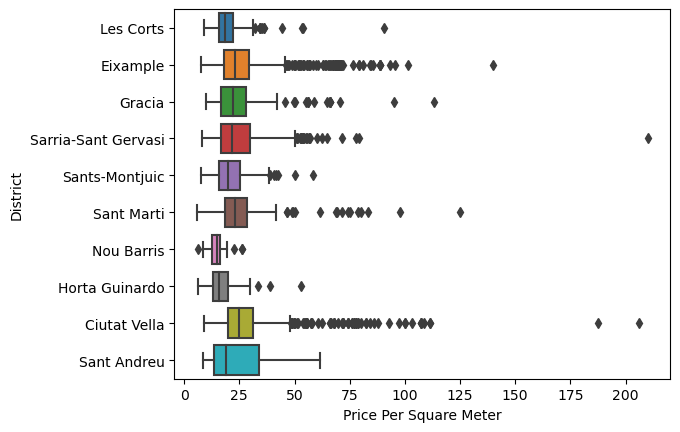

In [25]:
# Creating a boxplot that shows the price per square meter for each neighboorhood

sns.boxplot(x='PricePerSquareMeter',y='n_distri', data=gdf_districts).set(
    xlabel='Price Per Square Meter', 
    ylabel='District')
plt.show()

#### After checking in with a domain expert (aka just people living in Barcelona), this seems to validly represent the rental pricing in Barcelona, so the data obtained through webscraping has external validity.

In [26]:
gdf_districts.shape

(4160, 11)

## Connecting more data! (air pollution, sound pollution)

Right now, my dataframe is a collection of 4160 flats. 
It contains:
- Rent Price
- Surface
- Price per square meter
- Bathrooms
- Bedrooms
- Neighborhood and district [district from another dataset]
- Distance to center
- Latitude and Longitude of each flat

Now I want to use geojson datasets with information about the air pollution and another one about noise pollution and create a spacial join with my flats (basically, I want to know for each flat the air pollution and noise pollution).

In [27]:
# Reading the air pollution GeoJSON file into a GeoDataFrame

no2 = gpd.read_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/2018_tramer_no2_mapa_qualitat_aire_bcn.geojson')

no2

,TRAM,Rang,geometry
0,T04719W,30 - 40 µg/m³,"MULTILINESTRING ((430229.789 4586585.199, 4301..."
1,T19941Z,30 - 40 µg/m³,"MULTILINESTRING ((432928.898 4584019.988, 4329..."
2,T18111R,30 - 40 µg/m³,"MULTILINESTRING ((429953.263 4588161.441, 4299..."
3,T03222Y,30 - 40 µg/m³,"MULTILINESTRING ((427949.038 4580946.043, 4279..."
4,T17625I,40 - 50 µg/m³,"MULTILINESTRING ((433950.189 4585741.214, 4338..."
...,...,...,...
15036,T17103N,30 - 40 µg/m³,"MULTILINESTRING ((428029.879 4581292.346, 4281..."
15037,T07428A,30 - 40 µg/m³,"MULTILINESTRING ((427903.283 4582223.115, 4278..."
15038,T02455J,40 - 50 µg/m³,"MULTILINESTRING ((428305.440 4581748.228, 4283..."
15039,T08868Y,30 - 40 µg/m³,"MULTILINESTRING ((431756.999 4585026.456, 4317..."


In [28]:
no2_exploded = no2.explode(ignore_index=False)

no2_exploded

C:\Users\a\AppData\Local\Temp\ipykernel_16296\220878979.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  no2_exploded = no2.explode(ignore_index=False)


,,TRAM,Rang,geometry
0,0,T04719W,30 - 40 µg/m³,"LINESTRING (430229.789 4586585.199, 430181.877..."
1,0,T19941Z,30 - 40 µg/m³,"LINESTRING (432928.898 4584019.988, 432994.984..."
2,0,T18111R,30 - 40 µg/m³,"LINESTRING (429953.263 4588161.441, 429981.418..."
3,0,T03222Y,30 - 40 µg/m³,"LINESTRING (427949.038 4580946.043, 427950.735..."
4,0,T17625I,40 - 50 µg/m³,"LINESTRING (433950.189 4585741.214, 433875.041..."
...,...,...,...,...
15036,0,T17103N,30 - 40 µg/m³,"LINESTRING (428029.879 4581292.346, 428102.743..."
15037,0,T07428A,30 - 40 µg/m³,"LINESTRING (427903.283 4582223.115, 427860.637..."
15038,0,T02455J,40 - 50 µg/m³,"LINESTRING (428305.440 4581748.228, 428334.560..."
15039,0,T08868Y,30 - 40 µg/m³,"LINESTRING (431756.999 4585026.456, 431724.794..."


#### Need to change the crs system to the same and fitting one to do (meaningful) spacial joins:

In [29]:
gdf_districts.crs = "EPSG:4326"

In [30]:
gdf_districts = gdf_districts.to_crs(epsg=4326)

In [31]:
# no2_exploded_epsg25831 = no2_exploded.to_crs(epsg=25831)

In [32]:
no2_exploded_epsg4326 = no2_exploded.to_crs(epsg=4326)

In [33]:
no2_exploded

,,TRAM,Rang,geometry
0,0,T04719W,30 - 40 µg/m³,"LINESTRING (430229.789 4586585.199, 430181.877..."
1,0,T19941Z,30 - 40 µg/m³,"LINESTRING (432928.898 4584019.988, 432994.984..."
2,0,T18111R,30 - 40 µg/m³,"LINESTRING (429953.263 4588161.441, 429981.418..."
3,0,T03222Y,30 - 40 µg/m³,"LINESTRING (427949.038 4580946.043, 427950.735..."
4,0,T17625I,40 - 50 µg/m³,"LINESTRING (433950.189 4585741.214, 433875.041..."
...,...,...,...,...
15036,0,T17103N,30 - 40 µg/m³,"LINESTRING (428029.879 4581292.346, 428102.743..."
15037,0,T07428A,30 - 40 µg/m³,"LINESTRING (427903.283 4582223.115, 427860.637..."
15038,0,T02455J,40 - 50 µg/m³,"LINESTRING (428305.440 4581748.228, 428334.560..."
15039,0,T08868Y,30 - 40 µg/m³,"LINESTRING (431756.999 4585026.456, 431724.794..."


In [34]:
gdf_districts

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter,n_distri
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128,Les Corts
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481,Eixample
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667,Gracia
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000,Eixample
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039,Sarria-Sant Gervasi
...,...,...,...,...,...,...,...,...,...,...,...
4180,2100,150,4.0,2.0,Poblenou,41.403355,2.202884,3.159278,POINT (2.20288 41.40335),14.000000,Sant Marti
4181,1100,90,3.0,2.0,La Marina-Montjuic,41.357952,2.139122,4.185492,POINT (2.13912 41.35795),12.222222,Sants-Montjuic
4182,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi
4183,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi


In [35]:
import folium
import matplotlib
import mapclassify

no2.explore()

In [36]:
gdf_districts.explore()

In [37]:
# Performing the merge
gdf_districts_no2 = gpd.sjoin_nearest(gdf_districts, no2_exploded_epsg4326, how='left')

display(gdf_districts_no2.shape)
gdf_districts_no2

C:\Users\a\anaconda3\lib\site-packages\geopandas\array.py:344: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


(4163, 15)

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter,n_distri,index_right0,index_right1,TRAM,Rang
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128,Les Corts,8037,0,T07559K,30 - 40 µg/m³
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481,Eixample,7275,0,T02463J,40 - 50 µg/m³
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667,Gracia,3196,0,T08214S,40 - 50 µg/m³
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000,Eixample,10347,0,T02619L,40 - 50 µg/m³
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039,Sarria-Sant Gervasi,2285,0,T10560G,50 - 60 µg/m³
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4180,2100,150,4.0,2.0,Poblenou,41.403355,2.202884,3.159278,POINT (2.20288 41.40335),14.000000,Sant Marti,11081,0,T09159G,40 - 50 µg/m³
4181,1100,90,3.0,2.0,La Marina-Montjuic,41.357952,2.139122,4.185492,POINT (2.13912 41.35795),12.222222,Sants-Montjuic,13269,0,T21458S,30 - 40 µg/m³
4182,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,8391,0,T10915N,30 - 40 µg/m³
4183,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,8391,0,T10915N,30 - 40 µg/m³


In [38]:
gdf_districts_no2['Rang'].unique()

array(['30 - 40 µg/m³', '40 - 50 µg/m³', '50 - 60 µg/m³', '20 - 30 µg/m³',
       '> 70 µg/m³', '60 - 70 µg/m³', '<= 20 µg/m³'], dtype=object)

In [39]:
# Cleaning up unnecessary columns from the merge

gdf_districts_no2 = gdf_districts_no2.drop(columns=['index_right0','index_right1','TRAM'])

In [40]:
# Renaming n_distri and Rang to something more obvious

gdf_districts_no2.rename(columns={'n_distri': 'District', 'Rang': 'AirPollutionNO2'}, inplace=True)

### Getting the noise pullution in there, too

In [41]:
# Reading the noise pollution GeoJSON file into a GeoDataFrame

noise = gpd.read_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/2017_tramer_mapa_estrategic_soroll_bcn.geojson')

noise

,TRAM,TOTAL_D,TOTAL_E,TOTAL_N,TOTAL_DEN,TRANSIT_D,TRANSIT_E,TRANSIT_N,TRANSIT_DEN,GI_TR_D,...,INDUST_D,INDUST_E,INDUST_N,INDUST_DEN,VIANANTS_D,VIANANTS_E,OCI_N,PATIS_D,PATIS_E,geometry
0,T04719W,70 - 75 dB(A),65 - 70 dB(A),60 - 65 dB(A),70 - 75 dB(A),70 - 75 dB(A),65 - 70 dB(A),60 - 65 dB(A),70 - 75 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((430229.789 4586585.199, 4301..."
1,T19941Z,45 - 50 dB(A),45 - 50 dB(A),< 40 dB(A),45 - 50 dB(A),40 - 45 dB(A),40 - 45 dB(A),< 40 dB(A),45 - 50 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),45 - 50 dB(A),45 - 50 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((432928.898 4584019.988, 4329..."
2,T18111R,55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),55 - 60 dB(A),55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),55 - 60 dB(A),40 - 45 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((429953.263 4588161.441, 4299..."
3,T03222Y,60 - 65 dB(A),55 - 60 dB(A),60 - 65 dB(A),65 - 70 dB(A),60 - 65 dB(A),55 - 60 dB(A),50 - 55 dB(A),60 - 65 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),50 - 55 dB(A),50 - 55 dB(A),60 - 65 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((427949.038 4580946.043, 4279..."
4,T17625I,55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),60 - 65 dB(A),55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),60 - 65 dB(A),55 - 60 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((433950.189 4585741.214, 4338..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17953,T08868Y,55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),55 - 60 dB(A),55 - 60 dB(A),55 - 60 dB(A),50 - 55 dB(A),55 - 60 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((431756.999 4585026.456, 4317..."
17954,P98700,50 - 55 dB(A),40 - 45 dB(A),< 40 dB(A),50 - 55 dB(A),40 - 45 dB(A),40 - 45 dB(A),< 40 dB(A),40 - 45 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),50 - 55 dB(A),< 40 dB(A),"MULTILINESTRING ((433540.328 4587660.452, 4335..."
17955,P98690,40 - 45 dB(A),< 40 dB(A),< 40 dB(A),40 - 45 dB(A),40 - 45 dB(A),< 40 dB(A),< 40 dB(A),40 - 45 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),"MULTILINESTRING ((433545.366 4587658.255, 4335..."
17956,P27312,50 - 55 dB(A),40 - 45 dB(A),< 40 dB(A),50 - 55 dB(A),40 - 45 dB(A),40 - 45 dB(A),< 40 dB(A),40 - 45 dB(A),< 40 dB(A),...,< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),< 40 dB(A),50 - 55 dB(A),< 40 dB(A),"MULTILINESTRING ((430555.994 4585460.656, 4305..."


In [42]:
noise.columns

Index(['TRAM', 'TOTAL_D', 'TOTAL_E', 'TOTAL_N', 'TOTAL_DEN', 'TRANSIT_D',
       'TRANSIT_E', 'TRANSIT_N', 'TRANSIT_DEN', 'GI_TR_D', 'GI_TR_E',
       'GI_TR_N', 'GI_TR_DEN', 'FFCC_D', 'FFCC_E', 'FFCC_N', 'FFCC_DEN',
       'INDUST_D', 'INDUST_E', 'INDUST_N', 'INDUST_DEN', 'VIANANTS_D',
       'VIANANTS_E', 'OCI_N', 'PATIS_D', 'PATIS_E', 'geometry'],
      dtype='object')

In [43]:
# I know that TOTAL_DEN is the average and TOTAL_D is for Day, TOTAL_E for midday/evening and TOTAL_N for night. 
# I'm choosing the TOTAL_DEN to use, so only keeping TOTAL_DEN and geometry to keep

noise = noise.drop(columns=['TRAM', 'TOTAL_D', 'TOTAL_E', 'TOTAL_N', 'TRANSIT_D',
       'TRANSIT_E', 'TRANSIT_N', 'TRANSIT_DEN', 'GI_TR_D', 'GI_TR_E',
       'GI_TR_N', 'GI_TR_DEN', 'FFCC_D', 'FFCC_E', 'FFCC_N', 'FFCC_DEN',
       'INDUST_D', 'INDUST_E', 'INDUST_N', 'INDUST_DEN', 'VIANANTS_D',
       'VIANANTS_E', 'OCI_N', 'PATIS_D', 'PATIS_E'])

# Renaming the column to something more obvious

noise.rename(columns={'TOTAL_DEN': 'Noise'}, inplace=True)

In [44]:
noise = noise.to_crs(epsg=4326)

In [45]:
noise.explore()

In [46]:
# Performing the merge
gdf_districts_no2_noise = gpd.sjoin_nearest(gdf_districts_no2, noise, how='left')

# Cleaning up unnecessary columns from the merge
gdf_districts_no2_noise = gdf_districts_no2_noise.drop(columns=['index_right'])

display(gdf_districts_no2_noise.shape)
gdf_districts_no2_noise

C:\Users\a\anaconda3\lib\site-packages\geopandas\array.py:344: UserWarning: Geometry is in a geographic CRS. Results from 'sjoin_nearest' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  warnings.warn(


(4163, 13)

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter,District,AirPollutionNO2,Noise
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128,Les Corts,30 - 40 µg/m³,65 - 70 dB(A)
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481,Eixample,40 - 50 µg/m³,70 - 75 dB(A)
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667,Gracia,40 - 50 µg/m³,70 - 75 dB(A)
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000,Eixample,40 - 50 µg/m³,65 - 70 dB(A)
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039,Sarria-Sant Gervasi,50 - 60 µg/m³,75 - 80 dB(A)
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4180,2100,150,4.0,2.0,Poblenou,41.403355,2.202884,3.159278,POINT (2.20288 41.40335),14.000000,Sant Marti,40 - 50 µg/m³,65 - 70 dB(A)
4181,1100,90,3.0,2.0,La Marina-Montjuic,41.357952,2.139122,4.185492,POINT (2.13912 41.35795),12.222222,Sants-Montjuic,30 - 40 µg/m³,65 - 70 dB(A)
4182,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,30 - 40 µg/m³,65 - 70 dB(A)
4183,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,30 - 40 µg/m³,65 - 70 dB(A)


In [47]:
# Looking at the value for air pollution and noise, I still need to change them into single values.

# I will choose the mean for air pollution, so e.g. '30 - 40 µg/m³' will become '35' and so on.
# For noise pollution, I'll choose the higher value, e.g. '40 - 45 dB(A)' will be interpreted as '45'.

display(gdf_districts_no2_noise['AirPollutionNO2'].unique())

display(gdf_districts_no2_noise['Noise'].unique())

array(['30 - 40 µg/m³', '40 - 50 µg/m³', '50 - 60 µg/m³', '20 - 30 µg/m³',
       '> 70 µg/m³', '60 - 70 µg/m³', '<= 20 µg/m³'], dtype=object)

array(['65 - 70 dB(A)', '70 - 75 dB(A)', '75 - 80 dB(A)', '60 - 65 dB(A)',
       '55 - 60 dB(A)', '50 - 55 dB(A)', '45 - 50 dB(A)', '40 - 45 dB(A)',
       '< 40 dB(A)'], dtype=object)

In [48]:
# Creating a mapping dictionary for air pollution
mapping = {
    '<= 20 µg/m³': '15',
    '20 - 30 µg/m³': '25',
    '30 - 40 µg/m³': '35',
    '40 - 50 µg/m³': '45',
    '50 - 60 µg/m³': '55',
    '60 - 70 µg/m³': '65',
    '> 70 µg/m³': '75'
}

# Replacing air pollution values with single numbers
gdf_districts_no2_noise['AirPollutionNO2'] = gdf_districts_no2_noise['AirPollutionNO2'].replace(mapping)
gdf_districts_no2_noise['AirPollutionNO2'] = gdf_districts_no2_noise['AirPollutionNO2'].astype('int')

In [49]:
# Creating a mapping dictionary for noise pollution
mapping = {
    '< 40 dB(A)': '40',
    '40 - 45 dB(A)': '45',
    '45 - 50 dB(A)': '50',
    '50 - 55 dB(A)': '55',
    '55 - 60 dB(A)': '60',
    '60 - 65 dB(A)': '65',
    '65 - 70 dB(A)': '70',
    '70 - 75 dB(A)': '75',
    '75 - 80 dB(A)': '80'
}

# Replacing noise pollution values with single numbers
gdf_districts_no2_noise['Noise'] = gdf_districts_no2_noise['Noise'].replace(mapping)
gdf_districts_no2_noise['Noise'] = gdf_districts_no2_noise['Noise'].astype('int')

In [50]:
gdf_districts_no2_noise

,RentPrice,Surface,Bedrooms,Bathrooms,Neighborhood,Latitude,Longitude,DistanceToCenter,geometry,PricePerSquareMeter,District,AirPollutionNO2,Noise
0,2450,156,3.0,3.0,Les Corts,41.384470,2.110728,5.541253,POINT (2.11073 41.38447),15.705128,Les Corts,35,70
1,850,27,1.0,1.0,Esquerra Alta de l'Eixample,41.386516,2.142926,2.884969,POINT (2.14293 41.38652),31.481481,Eixample,45,75
2,1290,45,2.0,1.0,Vila de Gracia,41.402398,2.162556,2.519144,POINT (2.16256 41.40240),28.666667,Gracia,45,75
3,1600,80,3.0,1.0,Sagrada Familia,41.407584,2.176920,2.784450,POINT (2.17692 41.40758),20.000000,Eixample,45,70
5,2500,127,3.0,2.0,Sant Gervasi - Galvany,41.398901,2.143240,3.359485,POINT (2.14324 41.39890),19.685039,Sarria-Sant Gervasi,55,80
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4180,2100,150,4.0,2.0,Poblenou,41.403355,2.202884,3.159278,POINT (2.20288 41.40335),14.000000,Sant Marti,45,70
4181,1100,90,3.0,2.0,La Marina-Montjuic,41.357952,2.139122,4.185492,POINT (2.13912 41.35795),12.222222,Sants-Montjuic,35,70
4182,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,35,70
4183,1250,80,1.0,2.0,Tres Torres,41.400906,2.125186,4.787668,POINT (2.12519 41.40091),15.625000,Sarria-Sant Gervasi,35,70


# Creating SQL Database from my dataframe

I will comment this out so I don't need to rerun and re-enter the password everytime is restart the kernel

In [51]:
# import pymysql
# from sqlalchemy import create_engine
# from sqlalchemy import MetaData
# import getpass
# password = getpass.getpass()
# from sqlalchemy_utils import database_exists, create_database
# import pandas as pd

In [52]:
# connection_string = 'mysql+pymysql://root:' + password + '@localhost/mid_project'
# engine = create_engine(connection_string)
# if not database_exists(engine.url):
#     create_database(engine.url)
    
# gdf_districts_no2_noise.to_sql("flatsbcn", engine, if_exists="replace")

# Hypothesis

##### H1: Air pollution and noise pollution have a statistically significant, positive correlation.
    - H0: There is no significant correlation between air pollution and noise pollution
    - H1: There is a significant positive correlation between air pollution and noise pollution

##### H2: The surface area of a flat will increase statistically significant with the increase in distance to the city center (more space available).
    - H0: The surface area of the flat doesn't significantly increase with the increase of the distance to the city center
    - H1: The surface area increases significantly with the distance to the  city center

##### H3: For an increase in the price per square meter, there will also be a statistically significant increase in the rent price.
    - H0: The slope between the two variables is equal to zero
    - H1: The slope between the two variables is not equal to zero (i.e., there is a relationship between the two variables)
    
##### H4: There is a significant decrease in air pollution with an increase in the distance to the city center.
    - H0: The air pollution is the same for any distance from the center
    - H1: The air pollution significantly decreases with an increase in distance from the center

### H1

In [53]:
# H1: Testing the significance of the correlation

from scipy.stats import pearsonr

# Calculating the Pearson correlation coefficient and the p-value
corr, p = pearsonr(gdf_districts_no2_noise['AirPollutionNO2'], gdf_districts_no2_noise['Noise'])

# Printing the correlation coefficient and the p-value
print(f'Correlation coefficient: {corr:.2f}')
print(f'p-value: {p:.4f}')

Correlation coefficient: 0.50
p-value: 0.0000


In [54]:
# H1: Testing the significance of the slope

from scipy.stats import linregress

# Fit a linear regression model
slope, intercept, r_value, p_value, std_err = linregress(gdf_districts_no2_noise['AirPollutionNO2'], gdf_districts_no2_noise['Noise'])

# Test the hypothesis that the slope is significantly different from zero
if p_value < 0.05:
    print("The slope is significantly different from zero.")
else:
    print("The slope is not significantly different from zero.")
    
print(f'p-value: {p:.4f}')

print(f'Correlation coefficient: {r_value:.2f}')

The slope is significantly different from zero.
p-value: 0.0000
Correlation coefficient: 0.50


### H2

In [55]:
# H2: Testing the significance of the slope

from scipy.stats import linregress

# Fit a linear regression model
slope, intercept, r_value, p_value, std_err = linregress(gdf_districts_no2_noise['Surface'], gdf_districts_no2_noise['DistanceToCenter'])

# Test the hypothesis that the slope is significantly different from zero
if p_value < 0.05:
    print("The slope is significantly different from zero.")
else:
    print("The slope is not significantly different from zero.")
    
print(f'p-value: {p:.4f}')

print(f'Correlation coefficient: {r_value:.2f}')

The slope is significantly different from zero.
p-value: 0.0000
Correlation coefficient: 0.25


### H3

In [56]:
# H3: Testing the significance of the slope

# Fit a linear regression model
slope, intercept, r_value, p_value, std_err = linregress(gdf_districts_no2_noise['RentPrice'], gdf_districts_no2_noise['PricePerSquareMeter'])

# Test the hypothesis that the slope is significantly different from zero
if p_value < 0.05:
    print("The slope is significantly different from zero.")
else:
    print("The slope is not significantly different from zero.")
    
print(f'p-value: {p:.4f}')

The slope is significantly different from zero.
p-value: 0.0000


### H4

In [57]:
# H4: Testing the significance of the slope

# Fit a linear regression model
slope, intercept, r_value, p_value, std_err = linregress(gdf_districts_no2_noise['AirPollutionNO2'], gdf_districts_no2_noise['DistanceToCenter'])

# Test the hypothesis that the slope is significantly different from zero
if p_value < 0.05:
    print("The slope is significantly different from zero.")
else:
    print("The slope is not significantly different from zero.")
    
print(f'p-value: {p:.4f}')

print(f'Correlation coefficient: {r_value:.2f}')

The slope is significantly different from zero.
p-value: 0.0000
Correlation coefficient: -0.43


_______________________________________________________________________________________________________

## Nice, let's look at some descriptive statistics and distributions

In [58]:
gdf_districts_no2_noise.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,4163.0,2210.865482,1911.040168,120.000000,1250.000000,1700.000000,2500.000000,25000.000000
Surface,4163.0,95.529666,72.526363,10.000000,58.000000,78.000000,106.000000,923.000000
Bedrooms,4163.0,2.388662,1.198384,1.000000,2.000000,2.000000,3.000000,16.000000
Bathrooms,4163.0,1.632717,0.946353,1.000000,1.000000,1.000000,2.000000,14.000000
Latitude,4163.0,41.395254,0.015386,41.324466,41.382821,41.394134,41.403630,41.462423
Longitude,4163.0,2.162041,0.022111,2.086004,2.146159,2.165803,2.177305,2.217561
DistanceToCenter,4163.0,2.654221,1.690764,0.043297,1.280555,2.573420,3.739996,8.885055
PricePerSquareMeter,4163.0,25.213279,13.803380,5.681818,16.987179,22.105263,28.571429,210.000000
AirPollutionNO2,4163.0,43.717271,9.982568,15.000000,35.000000,45.000000,45.000000,75.000000
Noise,4163.0,67.751621,7.236566,40.000000,65.000000,70.000000,75.000000,80.000000


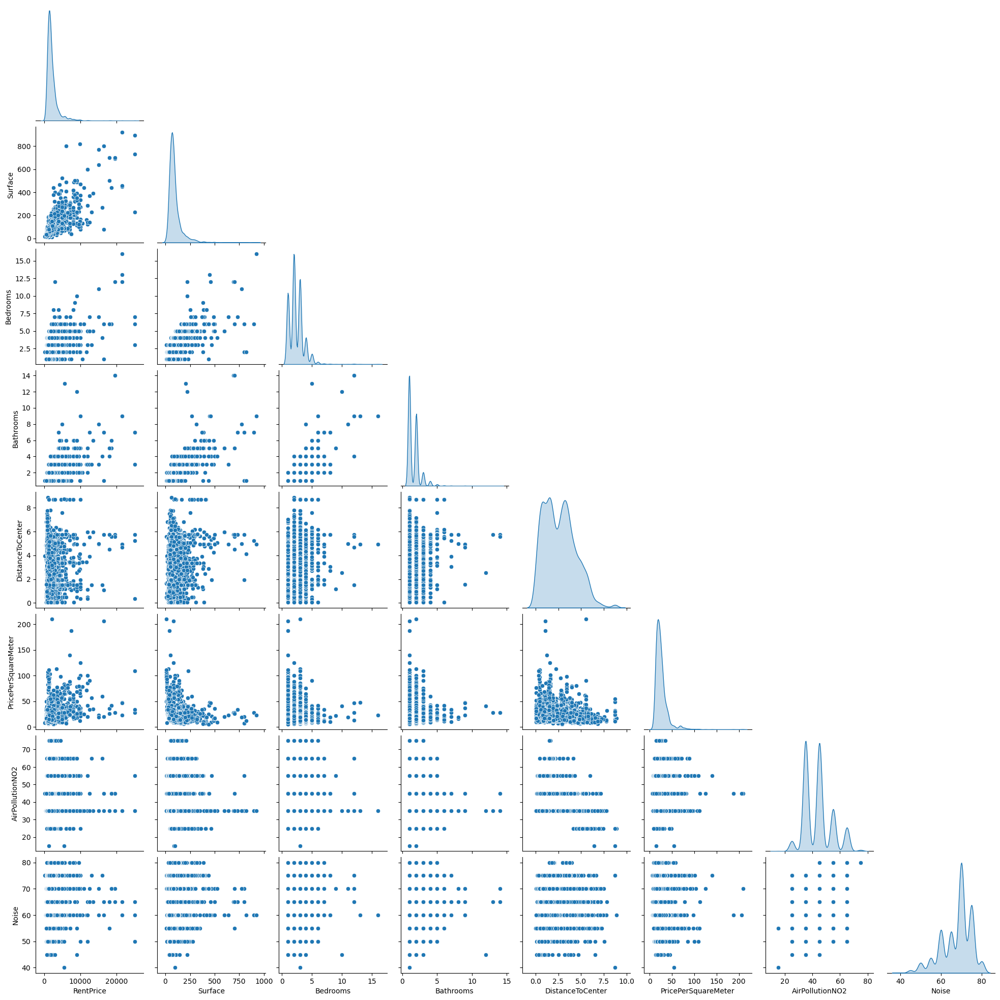

In [59]:
# Checking the distributions of my variables and relation to the other variables

df_attr = gdf_districts_no2_noise.iloc[:, [0,1,2,3,7,9,11,12]] # Selecting columns of interest

sns.pairplot(df_attr, diag_kind ="kde", corner = True); # pairplot

In [60]:
df_attr.skew(axis = 0, skipna = True)

RentPrice              4.855248
Surface                4.069451
Bedrooms               1.862473
Bathrooms              3.643554
DistanceToCenter       0.541653
PricePerSquareMeter    3.693274
AirPollutionNO2        0.622679
Noise                 -0.812436
dtype: float64

<AxesSubplot: >

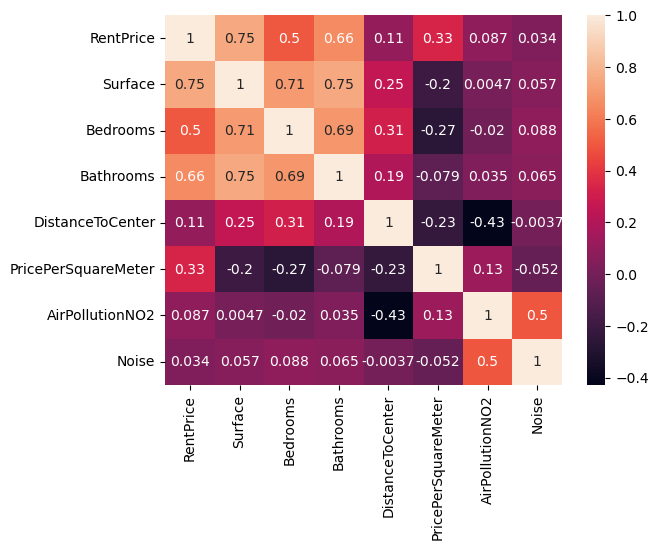

In [61]:
# Selecting the columns for my heatmap
columns = ['RentPrice', 'Surface', 'Bedrooms','Bathrooms','DistanceToCenter','PricePerSquareMeter','AirPollutionNO2','Noise']
df_selected = gdf_districts_no2_noise[columns]

# Calculating the correlations
corr = df_selected.corr()

# Creating the heatmap
sns.heatmap(corr, annot=True)

In [62]:
gdf_districts_no2_noise['District'].describe().T

count         4163
unique          10
top       Eixample
freq           983
Name: District, dtype: object

In [63]:
# Create a new dataframe that includes only the rows where 'Districts' is 'Ciutat Vella'
ciutat_vella = gdf_districts_no2_noise.query("District == 'Ciutat Vella'")
ciutat_vella.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,962.0,1727.907484,1345.872160,525.000000,1150.000000,1500.000000,1857.500000,25000.000000
Surface,962.0,66.907484,37.116695,10.000000,45.000000,60.000000,79.500000,390.000000
Bedrooms,962.0,1.757796,0.802290,1.000000,1.000000,2.000000,2.000000,6.000000
Bathrooms,962.0,1.329522,0.584701,1.000000,1.000000,1.000000,2.000000,6.000000
Latitude,962.0,41.381812,0.002860,41.375441,41.379713,41.381925,41.384272,41.390092
Longitude,962.0,2.176160,0.007338,2.163558,2.168147,2.177305,2.182448,2.191638
DistanceToCenter,962.0,0.619168,0.323846,0.043297,0.399132,0.599654,0.810443,1.341109
PricePerSquareMeter,962.0,28.681810,16.565655,8.914729,20.000000,24.880682,31.285714,206.250000
AirPollutionNO2,962.0,42.307692,5.486425,35.000000,35.000000,45.000000,45.000000,65.000000
Noise,962.0,64.371102,6.944444,45.000000,60.000000,65.000000,70.000000,75.000000


In [64]:
sarria = gdf_districts_no2_noise.query("District == 'Sarria-Sant Gervasi'")
sarria.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,712.0,2952.344101,2678.845344,120.000000,1500.000000,2300.000000,3500.000000,25000.000000
Surface,712.0,129.126404,103.178301,10.000000,66.000000,97.000000,149.000000,923.000000
Bedrooms,712.0,2.855337,1.581406,1.000000,2.000000,3.000000,3.000000,16.000000
Bathrooms,712.0,2.054775,1.320009,1.000000,1.000000,2.000000,3.000000,14.000000
Latitude,712.0,41.403102,0.006572,41.390573,41.398901,41.401348,41.407034,41.427420
Longitude,712.0,2.137557,0.011775,2.086004,2.132309,2.142174,2.145285,2.154917
DistanceToCenter,712.0,4.056494,1.071718,2.429231,3.359485,3.760678,4.442525,8.738485
PricePerSquareMeter,712.0,24.943712,12.836753,8.000000,16.666667,21.666667,30.002000,210.000000
AirPollutionNO2,712.0,41.643258,8.753331,15.000000,35.000000,35.000000,45.000000,55.000000
Noise,712.0,68.974719,8.731142,40.000000,60.000000,70.000000,75.000000,80.000000


In [65]:
eixample = gdf_districts_no2_noise.query("District == 'Eixample'")
eixample.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,983.0,2470.332655,1681.022519,630.000000,1500.000000,1950.000000,2750.000000,16000.000000
Surface,983.0,99.564598,59.818187,10.000000,65.000000,85.000000,110.000000,800.000000
Bedrooms,983.0,2.474059,1.131429,1.000000,2.000000,2.000000,3.000000,12.000000
Bathrooms,983.0,1.708037,0.777226,1.000000,1.000000,2.000000,2.000000,9.000000
Latitude,983.0,41.391757,0.007206,41.376085,41.385262,41.393300,41.394623,41.410062
Longitude,983.0,2.164548,0.008633,2.142784,2.156220,2.166375,2.168616,2.185724
DistanceToCenter,983.0,1.771529,0.409549,0.822978,1.508042,1.664134,1.948330,3.064427
PricePerSquareMeter,983.0,26.892332,14.676454,7.500000,18.027778,22.857143,29.238026,140.000000
AirPollutionNO2,983.0,55.478128,8.459517,35.000000,45.000000,55.000000,65.000000,75.000000
Noise,983.0,71.642930,5.997425,50.000000,70.000000,75.000000,75.000000,80.000000


In [66]:
noubarris = gdf_districts_no2_noise.query("District == 'Nou Barris'")
noubarris.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,73.0,1061.000000,284.488430,600.000000,880.000000,950.000000,1200.000000,2350.000000
Surface,73.0,76.054795,26.697841,23.000000,60.000000,73.000000,90.000000,187.000000
Bedrooms,73.0,2.821918,0.787797,1.000000,2.000000,3.000000,3.000000,4.000000
Bathrooms,73.0,1.205479,0.406848,1.000000,1.000000,1.000000,1.000000,2.000000
Latitude,73.0,41.438530,0.007457,41.427409,41.432289,41.439223,41.443845,41.462423
Longitude,73.0,2.174704,0.005306,2.164036,2.169060,2.174831,2.178699,2.184353
DistanceToCenter,73.0,6.245275,0.818747,5.031089,5.575164,6.395753,6.827763,8.885055
PricePerSquareMeter,73.0,14.662112,3.374014,6.417112,12.777778,14.848485,16.326531,26.388889
AirPollutionNO2,73.0,32.945205,4.988571,25.000000,35.000000,35.000000,35.000000,45.000000
Noise,73.0,62.945205,6.057343,45.000000,60.000000,65.000000,65.000000,75.000000


In [67]:
santandreu = gdf_districts_no2_noise.query("District == 'Sant Andreu'")
santandreu.describe().T

,count,mean,std,min,25%,50%,75%,max
RentPrice,99.0,1274.333333,346.092532,740.000000,980.000000,1200.000000,1690.000000,2000.000000
Surface,99.0,67.050505,29.702049,25.000000,41.500000,62.000000,83.000000,188.000000
Bedrooms,99.0,2.202020,0.958100,1.000000,1.000000,2.000000,3.000000,4.000000
Bathrooms,99.0,1.232323,0.491318,1.000000,1.000000,1.000000,1.000000,4.000000
Latitude,99.0,41.428835,0.008797,41.416635,41.422477,41.425258,41.434734,41.452103
Longitude,99.0,2.186334,0.005353,2.180584,2.181161,2.186408,2.188210,2.203937
DistanceToCenter,99.0,5.217410,1.010269,3.851878,4.453312,4.758466,5.911336,7.812226
PricePerSquareMeter,99.0,22.841618,12.251753,8.571429,13.629189,18.840580,33.698113,61.666667
AirPollutionNO2,99.0,36.616162,3.699716,35.000000,35.000000,35.000000,35.000000,45.000000
Noise,99.0,65.353535,5.261165,55.000000,60.000000,65.000000,70.000000,75.000000


# Linear Regression Model to predict the rent price

In [68]:
from sklearn.linear_model import LinearRegression

# Create a LinearRegression model
model = LinearRegression()

# Define the predictors (X) and the target (y)
X = gdf_districts_no2_noise[['Surface', 'Bedrooms', 'Bathrooms', 'Latitude', 'Longitude', 'DistanceToCenter', 'AirPollutionNO2', 'Noise']]
y = gdf_districts_no2_noise['RentPrice']

# Fit the model to the data
model.fit(X, y)

# Print the coefficients of the model
print(model.coef_)

# Print the intercept of the model
print(model.intercept_)

[  17.43294134 -202.54260731  525.00709884 2799.39420747  833.73734854
  -54.47872914   15.24929238  -12.8726996 ]
-117162.00132231237


In [69]:
# Make predictions using the model
predictions = model.predict(X)


In [70]:
from sklearn.model_selection import cross_val_score

# Calculate the cross-validation scores
scores = cross_val_score(model, X, y, cv=5)

# Print the mean and standard deviation of the scores
print(f'Mean: {scores.mean():.2f}')
print(f'Standard deviation: {scores.std():.2f}')

Mean: 0.58
Standard deviation: 0.11


### Trying again with normalization

In [71]:
# Normalize between 0 and 1

from sklearn.preprocessing import MinMaxScaler

MinMaxtransformer = MinMaxScaler().fit(X)
X_normalized = MinMaxtransformer.transform(X)
print(X_normalized.shape)
X_normalized = pd.DataFrame(X_normalized,columns=X.columns)
X_normalized.head()

(4163, 8)


,Surface,Bedrooms,Bathrooms,Latitude,Longitude,DistanceToCenter,AirPollutionNO2,Noise
0,0.159912,0.133333,0.153846,0.434947,0.187936,0.621817,0.333333,0.750
1,0.018620,0.000000,0.000000,0.449778,0.432682,0.321392,0.500000,0.875
2,0.038335,0.066667,0.000000,0.564902,0.581897,0.280017,0.500000,0.875
3,0.076670,0.133333,0.000000,0.602492,0.691078,0.310023,0.500000,0.750
4,0.128149,0.133333,0.076923,0.539551,0.435068,0.375060,0.666667,1.000


In [72]:
# Train-test split

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X_normalized, y, test_size=0.2, random_state=42)

In [73]:
from sklearn import linear_model

lm = linear_model.LinearRegression()
lm.fit(X_train,y_train)

LinearRegression()

In [74]:
print(lm.intercept_, lm.coef_, lm.score(X_normalized, y))

495.2557998375478 [ 1.62396824e+04 -2.69687046e+03  6.16879445e+03  5.74522897e+02
  1.01396282e+01 -7.00101667e+02  9.71378682e+02 -5.78434470e+02] 0.6039563433386353


#### Model Validation

In [75]:
# R²

# Evaluation on training portion of data (the one used for training the model)
from sklearn.metrics import r2_score

predictions = lm.predict(X_train)
r2_score(y_train, predictions)

0.6023761157176398

In [76]:
# Evalution on test portion of data

predictions_test = lm.predict(X_test)
r2_score(y_test, predictions_test)

0.6107277913036667

In [77]:
import statsmodels.api as sm

# Add constant to predictor variables
X = sm.add_constant(X)

# For this, y must be a list otherwise you get that good old "The indices for endog and exog are not aligned"-error
y = list(y)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.604
Model:                            OLS   Adj. R-squared:                  0.604
Method:                 Least Squares   F-statistic:                     793.5
Date:                Fri, 06 Jan 2023   Prob (F-statistic):               0.00
Time:                        09:34:30   Log-Likelihood:                -35429.
No. Observations:                4163   AIC:                         7.088e+04
Df Residuals:                    4154   BIC:                         7.093e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                       coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------
const            -1.172e+05   8.62e+04  

### Figuring out automatically which combination of variables creates the best fitting model

In [78]:
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression

# Create a LinearRegression model
model = LinearRegression()

# Create the RFECV object
rfe = RFECV(model, cv=5)

# Fit the RFECV object to the data
rfe.fit(X, y)

# Print the optimal number of features and the selected features
print(f'Optimal number of features: {rfe.n_features_}')
print(f'Selected features: {X.columns[rfe.support_]}')


Optimal number of features: 8
Selected features: Index(['Surface', 'Bedrooms', 'Bathrooms', 'Latitude', 'Longitude',
       'DistanceToCenter', 'AirPollutionNO2', 'Noise'],
      dtype='object')


In [79]:
# Select the optimal number of features
X_opt = X[X.columns[rfe.support_]]

# Fit a linear regression model using the selected features
model.fit(X_opt, y)

# Calculate the cross-validation scores
scores = cross_val_score(model, X_opt, y, cv=5)

# Print the mean and standard deviation of the scores
print(f'Mean: {scores.mean():.2f}')
print(f'Standard deviation: {scores.std():.2f}')

Mean: 0.58
Standard deviation: 0.11


## Trying to add categorical data to the model

In [80]:
X_num = gdf_districts_no2_noise[['Surface', 'Bedrooms', 'Bathrooms', 'Latitude', 'Longitude', 'DistanceToCenter', 'AirPollutionNO2', 'Noise']]
X_cat = gdf_districts_no2_noise[['District']]

In [81]:
# Normalize between 0 and 1

MinMaxtransformer = MinMaxScaler().fit(X_num)
X_normalized = MinMaxtransformer.transform(X_num)
print(X_normalized.shape)
X_normalized = pd.DataFrame(X_normalized,columns=X_num.columns)
X_normalized.head()

(4163, 8)


,Surface,Bedrooms,Bathrooms,Latitude,Longitude,DistanceToCenter,AirPollutionNO2,Noise
0,0.159912,0.133333,0.153846,0.434947,0.187936,0.621817,0.333333,0.750
1,0.018620,0.000000,0.000000,0.449778,0.432682,0.321392,0.500000,0.875
2,0.038335,0.066667,0.000000,0.564902,0.581897,0.280017,0.500000,0.875
3,0.076670,0.133333,0.000000,0.602492,0.691078,0.310023,0.500000,0.750
4,0.128149,0.133333,0.076923,0.539551,0.435068,0.375060,0.666667,1.000


In [82]:
from sklearn.preprocessing import OneHotEncoder
encoder = OneHotEncoder(drop='first').fit(X_cat)
encoded = encoder.transform(X_cat).toarray()
encoded
cols = encoder.get_feature_names_out(input_features=X_cat.columns)
cols

onehot_encoded = pd.DataFrame(encoded, columns=cols)
onehot_encoded

,District_Eixample,District_Gracia,District_Horta Guinardo,District_Les Corts,District_Nou Barris,District_Sant Andreu,District_Sant Marti,District_Sants-Montjuic,District_Sarria-Sant Gervasi
0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...
4158,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4159,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4160,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4161,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [83]:
X = pd.concat([X_normalized, onehot_encoded], axis=1)
X.head()

,Surface,Bedrooms,Bathrooms,Latitude,Longitude,DistanceToCenter,AirPollutionNO2,Noise,District_Eixample,District_Gracia,District_Horta Guinardo,District_Les Corts,District_Nou Barris,District_Sant Andreu,District_Sant Marti,District_Sants-Montjuic,District_Sarria-Sant Gervasi
0,0.159912,0.133333,0.153846,0.434947,0.187936,0.621817,0.333333,0.750,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
1,0.018620,0.000000,0.000000,0.449778,0.432682,0.321392,0.500000,0.875,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.038335,0.066667,0.000000,0.564902,0.581897,0.280017,0.500000,0.875,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.076670,0.133333,0.000000,0.602492,0.691078,0.310023,0.500000,0.750,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.128149,0.133333,0.076923,0.539551,0.435068,0.375060,0.666667,1.000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


In [84]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [85]:
from sklearn import linear_model

lm = linear_model.LinearRegression()
lm.fit(X_train,y_train)

LinearRegression()

In [86]:
print(lm.intercept_, lm.coef_, lm.score(X, y))

175.64559749651653 [16037.12293872 -2526.73385818  5994.59076836   414.21491635
   691.49254141  -840.16053274   750.20631267  -623.1181489
   205.57666201   299.43878071  -104.55458369   435.67084849
  -131.09072764   -22.0598225    137.47992974   161.65848158
   509.40436074] 0.6086093870538027


In [87]:
import statsmodels.api as sm

# Add constant to predictor variables
X = sm.add_constant(X)

# For this, y must be a list otherwise you get that good old "The indices for endog and exog are not aligned"-error
y = list(y)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.609
Model:                            OLS   Adj. R-squared:                  0.608
Method:                 Least Squares   F-statistic:                     380.1
Date:                Fri, 06 Jan 2023   Prob (F-statistic):               0.00
Time:                        09:34:30   Log-Likelihood:                -35404.
No. Observations:                4163   AIC:                         7.084e+04
Df Residuals:                    4145   BIC:                         7.096e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

In [88]:
# Evaluation on training portion of data (the one used for training the model)
from sklearn.metrics import r2_score

predictions = lm.predict(X_train)
r2_score(y_train, predictions)

0.6069681321313147

In [89]:
# Evalution on test portion of data

predictions_test = lm.predict(X_test)
r2_score(y_test, predictions_test)

0.615657961453959

## Maybe it's easier to predict price per square meter instead of rent price? Let's check

In [90]:
y = gdf_districts_no2_noise['PricePerSquareMeter']

In [91]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

lm = linear_model.LinearRegression()
lm.fit(X_train,y_train)

print(lm.intercept_, lm.coef_, lm.score(X, y))

28.493771379653275 [ 0.00000000e+00 -3.08856697e+01 -4.62697757e+01  4.61744240e+01
  3.36236109e+00  6.29902554e+00 -1.19112118e+01  7.70325607e+00
 -7.78308877e+00  1.41306183e+00  1.76373019e+00 -1.59036606e+00
  5.15941741e+00 -2.99997078e+00  1.24292941e+00  8.29770729e-01
  3.13072030e-02  5.89756287e+00] 0.14647619834777525


In [92]:
# Add constant to predictor variables
X = sm.add_constant(X)

# For this, y must be a list otherwise you get that good old "The indices for endog and exog are not aligned"-error
y = list(y)

#fit linear regression model
model = sm.OLS(y, X).fit()

#view model summary
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.147
Model:                            OLS   Adj. R-squared:                  0.144
Method:                 Least Squares   F-statistic:                     42.08
Date:                Fri, 06 Jan 2023   Prob (F-statistic):          1.61e-129
Time:                        09:34:30   Log-Likelihood:                -16503.
No. Observations:                4163   AIC:                         3.304e+04
Df Residuals:                    4145   BIC:                         3.316e+04
Df Model:                          17                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------------------------
const           

In [93]:
from sklearn.feature_selection import RFECV
from sklearn.linear_model import LinearRegression

# Create a LinearRegression model
model = LinearRegression()

# Create the RFECV object
rfe = RFECV(model, cv=5)

# Fit the RFECV object to the data
rfe.fit(X, y)

# Print the optimal number of features and the selected features
print(f'Optimal number of features: {rfe.n_features_}')
print(f'Selected features: {X.columns[rfe.support_]}')


Optimal number of features: 16
Selected features: Index(['Surface', 'Bedrooms', 'Bathrooms', 'Longitude', 'DistanceToCenter',
       'AirPollutionNO2', 'Noise', 'District_Eixample', 'District_Gracia',
       'District_Horta Guinardo', 'District_Les Corts', 'District_Nou Barris',
       'District_Sant Andreu', 'District_Sant Marti',
       'District_Sants-Montjuic', 'District_Sarria-Sant Gervasi'],
      dtype='object')


In [94]:
# Select the optimal number of features
X_opt = X[X.columns[rfe.support_]]

# Fit a linear regression model using the selected features
model.fit(X_opt, y)

# Calculate the cross-validation scores
scores = cross_val_score(model, X_opt, y, cv=5)

# Print the mean and standard deviation of the scores
print(f'Mean: {scores.mean():.2f}')
print(f'Standard deviation: {scores.std():.2f}')

Mean: 0.12
Standard deviation: 0.06


#### Definitely way harder to predict with this data. No way to combine the variables in a way that's good enough.

In [95]:
# # Exporting the GeoDataFrame as a GeoJSON file
# gdf_districts_no2_noise.to_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/gdf_districts_no2_noise.geojson', driver='GeoJSON')

In [96]:
# # Exporting the GeoDataFrame as a GeoJSON file
# gdf_districts.to_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/GeoJSON Mutlilinestring to Point tests/gdf_districts.geojson', driver='GeoJSON')

In [97]:
# # Exporting the GeoDataFrame as a GeoJSON file
# no2_exploded.to_file('C:/Users/a/Google Drive/IRONHACK Data Analysis Bootcamp/Mid-Project/GeoJSON Mutlilinestring to Point tests/no2_exploded.geojson', driver='GeoJSON')